# Experiment 2 - YOLOv8 nano (default parameters)

## 1. Setup

In [1]:
import os

### Run the ff. in CPU machine

In [11]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.114 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Setup complete ✅ (8 CPUs, 44.1 GB RAM, 93.6/246.0 GB disk)


In [4]:
!nvidia-smi

Wed May 24 02:03:56 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   52C    P8    17W / 140W |      2MiB / 16376MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## 2. Dataset Info

In [12]:
dataset_path = "/notebooks/maskon_dataset"
dirs = ['train', 'test', 'valid']
subdirs = ['images', 'labels']

In [6]:
for d in dirs:
    for s in subdirs:
        subdir_path = os.path.join(dataset_path, d, s)
        file_count = len(os.listdir(subdir_path))
        print(f'{d}/{s} file count: {file_count}')

train/images file count: 25320
train/labels file count: 25320
test/images file count: 3165
test/labels file count: 3165
valid/images file count: 3165
valid/labels file count: 3165


In [7]:
!wandb disabled

W&B disabled.


## 3. Train YOLOv8 nano

In [8]:
!yolo task=detect mode=train model=yolov8n.pt data={dataset_path}/data.yaml epochs=60 imgsz=640 plots=True

100%|███████████████████████████████████████| 6.23M/6.23M [00:00<00:00, 330MB/s]
Ultralytics YOLOv8.0.107 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
WARNING ⚠️ Upgrade to torch>=2.0.0 for deterministic training.
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/notebooks/maskon_dataset/data.yaml, epochs=60, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, ag

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



      40/60      3.06G     0.9473     0.6397      1.165         35        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all       3165       5245      0.904      0.867      0.926      0.686

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      41/60      3.46G     0.9348     0.6289      1.158         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



      43/60      3.01G     0.9326     0.6222      1.155         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all       3165       5245      0.904      0.871      0.927      0.688

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      44/60      3.21G     0.9263     0.6148      1.149         16        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all       3165       5245      0.904      0.871      0.927      0.689

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      45/60      3.12G     0.9184     0.6057      1.147         41        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all       3165       5245      0.905       0.87      0.927      0.689

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
      46/6

This `train` command will train the custom mask usage dataset and a `.pt` model will then be saved.

----

### 3.1 Training Results

In [3]:
from IPython.display import display, Image

In [5]:
RES_PATH = "/notebooks/nano/runs/detect/train"
!ls {RES_PATH}

F1_curve.png					train_batch0.jpg
PR_curve.png					train_batch1.jpg
P_curve.png					train_batch2.jpg
R_curve.png					val_batch0_labels.jpg
args.yaml					val_batch0_pred.jpg
confusion_matrix.png				val_batch1_labels.jpg
confusion_matrix_normalized.png			val_batch1_pred.jpg
events.out.tfevents.1684893870.nmque3u3qy.86.0	val_batch2_labels.jpg
results.csv					val_batch2_pred.jpg
results.png					weights


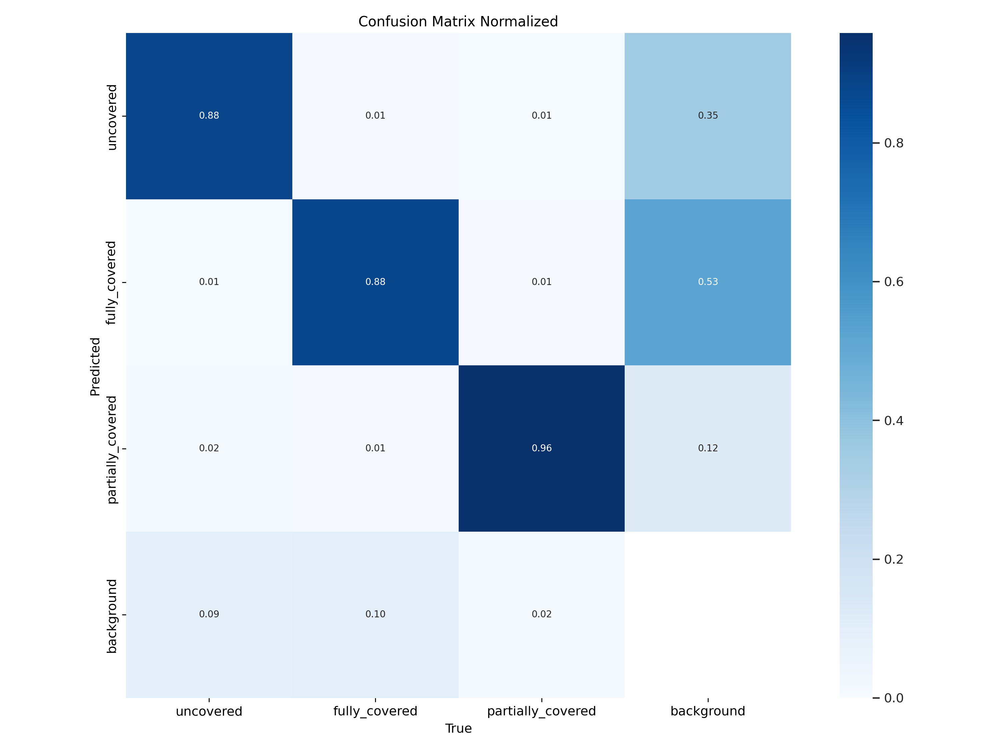

In [6]:
Image(filename=f'{RES_PATH}/confusion_matrix_normalized.png', width=640)

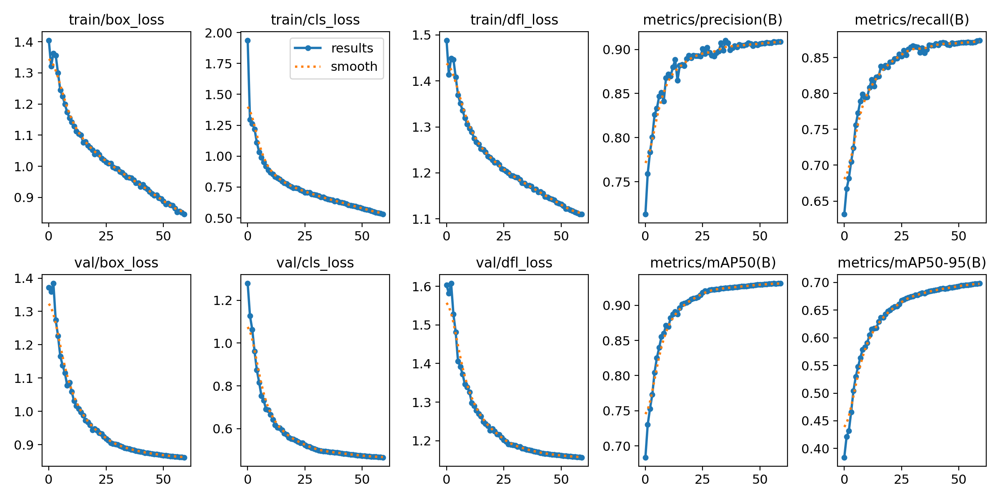

In [7]:
Image(filename=f'{RES_PATH}/results.png', width=600)

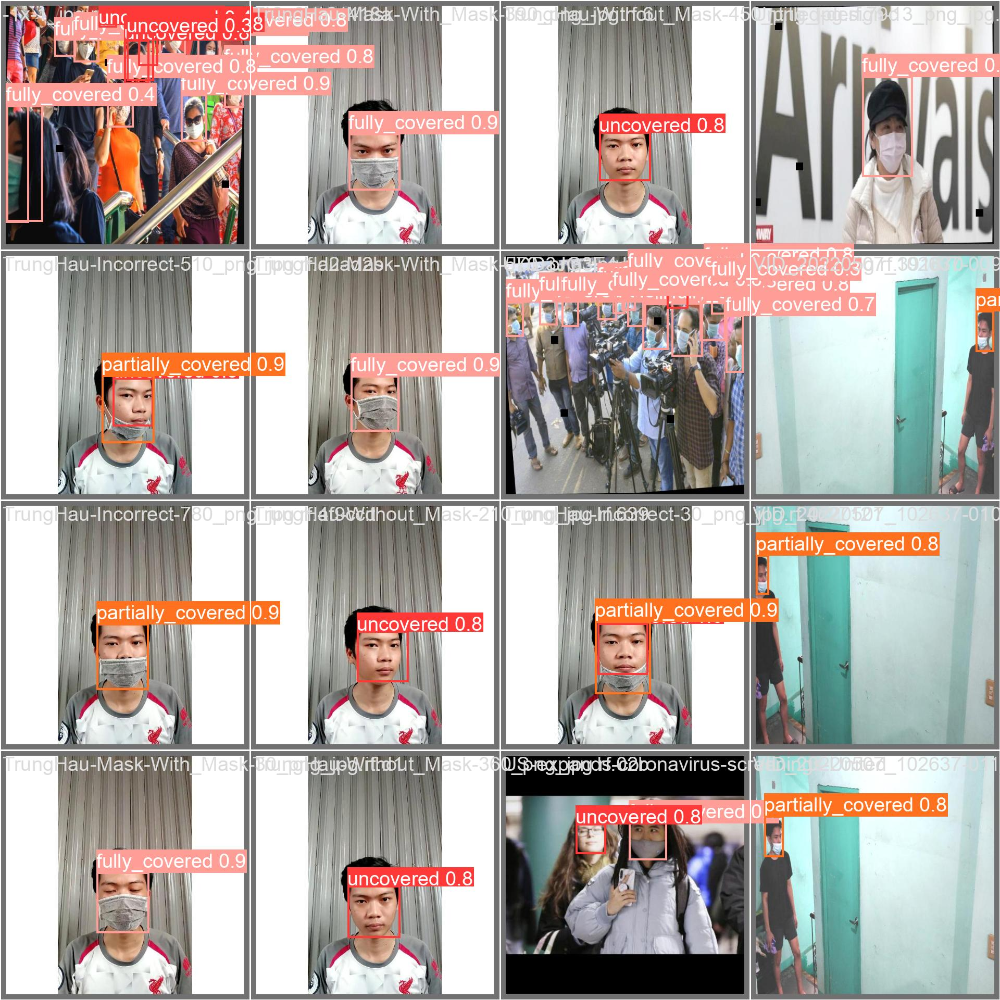

In [8]:
Image(filename=f'{RES_PATH}/val_batch0_pred.jpg', width=700)

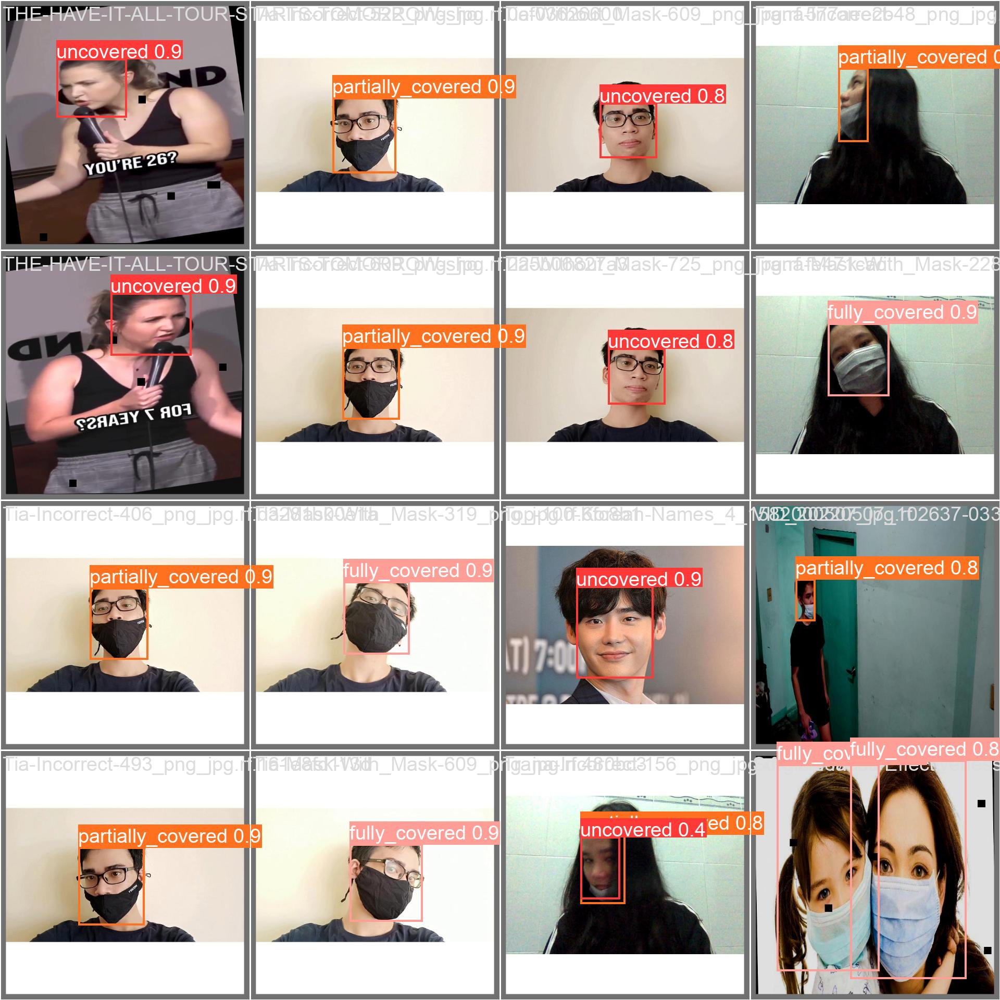

In [9]:
Image(filename=f'{RES_PATH}/val_batch1_pred.jpg', width=700)

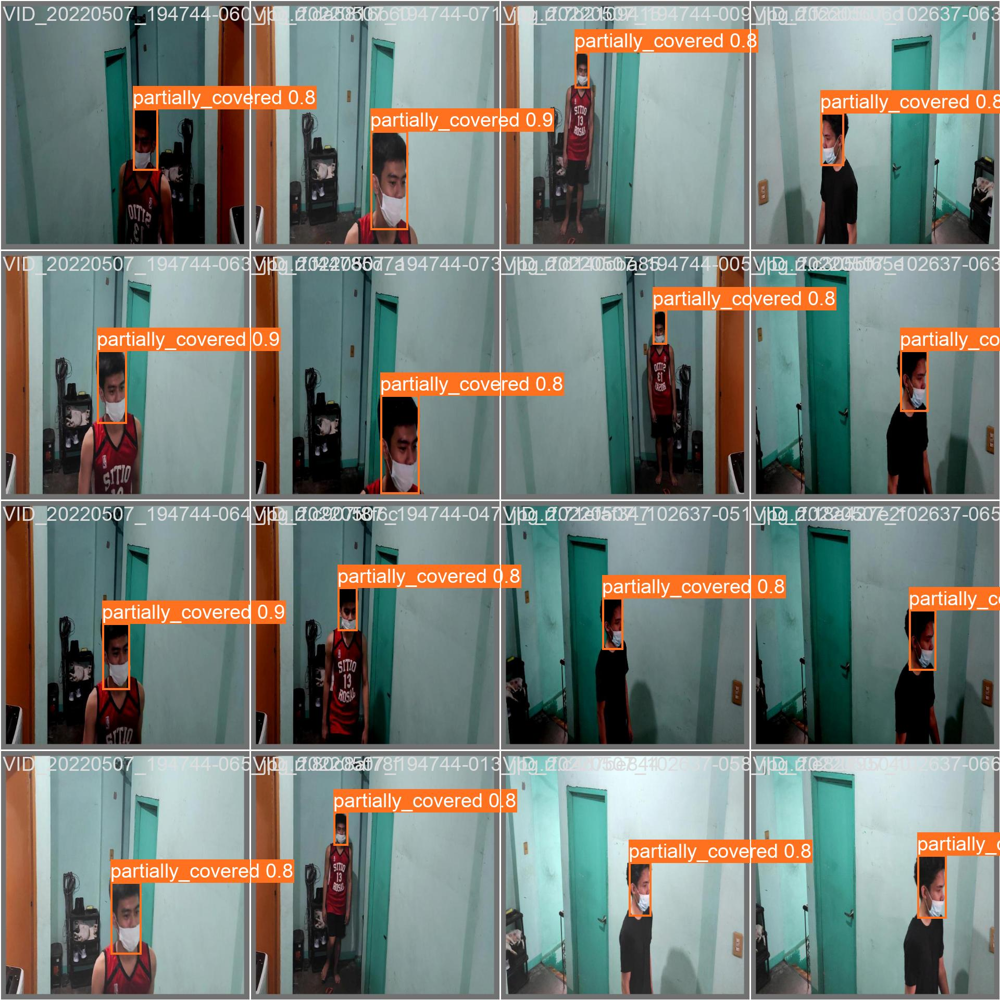

In [10]:
Image(filename=f'{RES_PATH}/val_batch2_pred.jpg', width=700)

----

## 4. Validate Custom Model

In [13]:
!yolo task=detect mode=val model={RES_PATH}/weights/best.pt data={dataset_path}/data.yaml

Ultralytics YOLOv8.0.114 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients
100%|█████████████████████████████████████████| 755k/755k [00:00<00:00, 120MB/s]
val: Scanning /notebooks/maskon_dataset/valid/labels.cache... 3165 images, 12 ba
val: WARNING ⚠️ /notebooks/maskon_dataset/valid/images/1940j_jpg.rf.1ddfe910dc43946930b6b872bbe2f457.jpg: 1 duplicate labels removed
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all       3165       5245      0.909      0.874      0.931      0.698
             uncovered       3165       1579      0.902      0.848      0.915      0.676
         fully_covered       3165       1666      0.859      0.824      0.896      0.609
     partially_covered       3165       2000      0.966       0.95      0.983      0.809
Speed: 0.2ms preprocess, 2.0ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/d

### 4.1 Test the custom model

In [14]:
!yolo task=detect mode=predict model={RES_PATH}/weights/best.pt conf=0.5 source={dataset_path}/test/images save=True

Ultralytics YOLOv8.0.114 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/3165 /notebooks/maskon_dataset/test/images/-1x-1_jpg.rf.a45473a343abb657cefa66adb8db92cf.jpg: 640x640 2 uncovereds, 2 fully_covereds, 6.3ms
image 2/3165 /notebooks/maskon_dataset/test/images/-I1-MS09uaqsLdGTFkgnS0Rcg1mmPyAj95ySg_eckoM_jpeg_jpg.rf.e689c0294bb6c6a98e565a4f7070d585.jpg: 640x640 2 fully_covereds, 6.1ms
image 3/3165 /notebooks/maskon_dataset/test/images/00003_Mask_Mouth_Chin_jpg.rf.48358e842329c6247a16b2de18a8ded9.jpg: 640x640 1 partially_covered, 6.0ms
image 4/3165 /notebooks/maskon_dataset/test/images/00004_Mask_Mouth_Chin_jpg.rf.be3ee8dcc8f3fae4cf38aedbe77f3ea2.jpg: 640x640 1 partially_covered, 6.6ms
image 5/3165 /notebooks/maskon_dataset/test/images/00007_Mask_Mouth_Chin_jpg.rf.6ead5a7442b10e7c25275cd135e3d986.jpg: 640x640 1 partially_covered, 6.1ms
image 6/3165 /notebooks/maskon_dataset/test/images/0

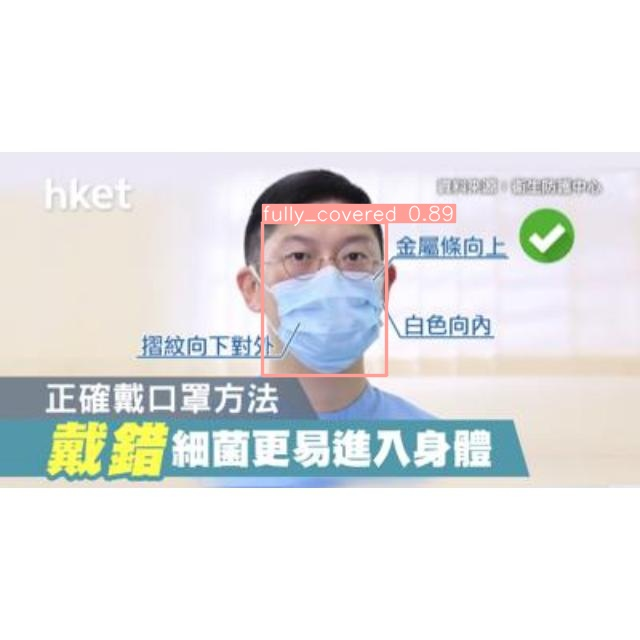

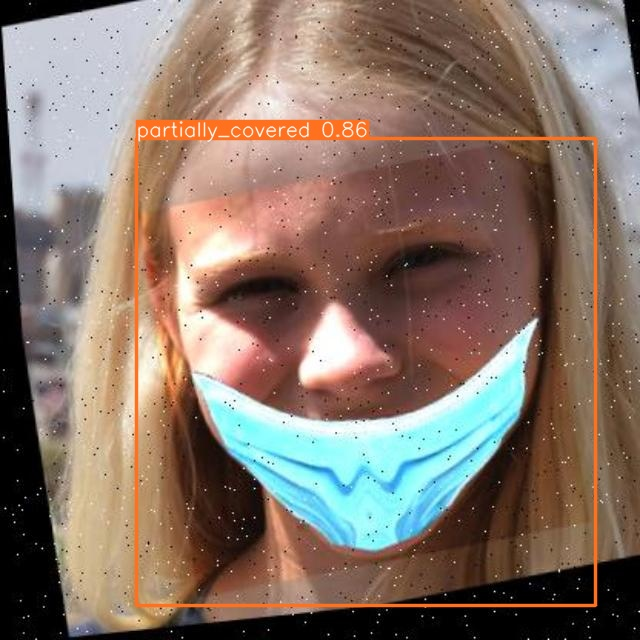

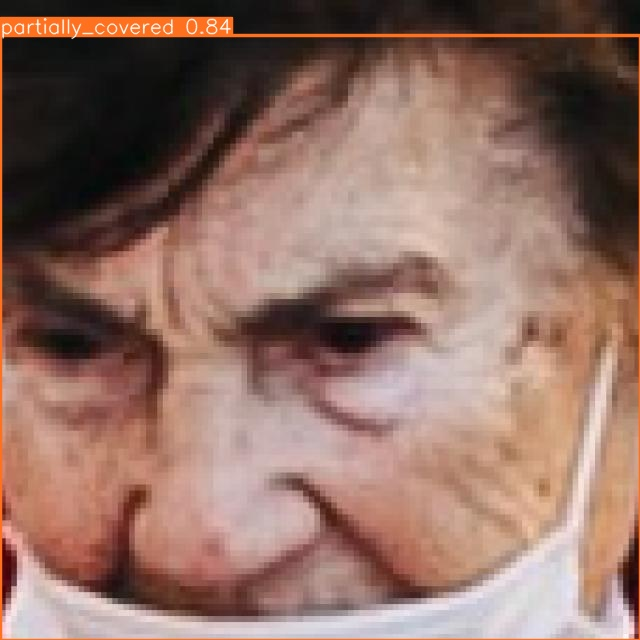

In [15]:
import glob
from IPython.display import display, Image

TEST_RES_PATH = "/notebooks/nano/runs/detect/predict5"

for image_path in glob.glob(f'{TEST_RES_PATH}/*.jpg')[:3]:
    display(Image(filename=image_path, width=400))
    print('\n')

### Test the custom model to some other cases

In [16]:
!yolo task=detect mode=predict model={RES_PATH}/weights/best.pt conf=0.5 source="/notebooks/datasets/sometestcases" save=True

Ultralytics YOLOv8.0.114 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/5 /notebooks/datasets/sometestcases/beard1.png: 288x640 3 uncovereds, 12.5ms
image 2/5 /notebooks/datasets/sometestcases/beard2.png: 288x640 3 uncovereds, 8.3ms
image 3/5 /notebooks/datasets/sometestcases/clear.png: 288x640 1 fully_covered, 3 partially_covereds, 8.1ms
image 4/5 /notebooks/datasets/sometestcases/realist.png: 288x640 6 uncovereds, 1 partially_covered, 8.1ms
image 5/5 /notebooks/datasets/sometestcases/skintone.png: 288x640 3 fully_covereds, 8.2ms
Speed: 1.6ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict6


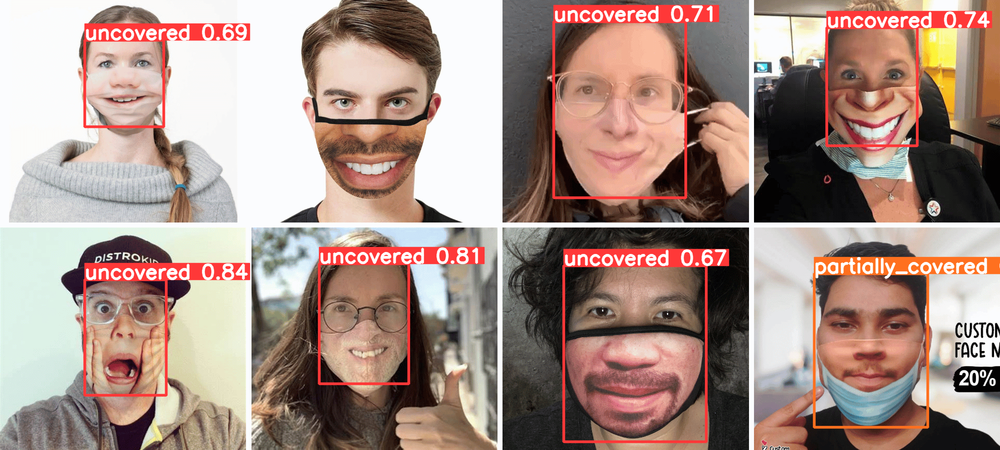

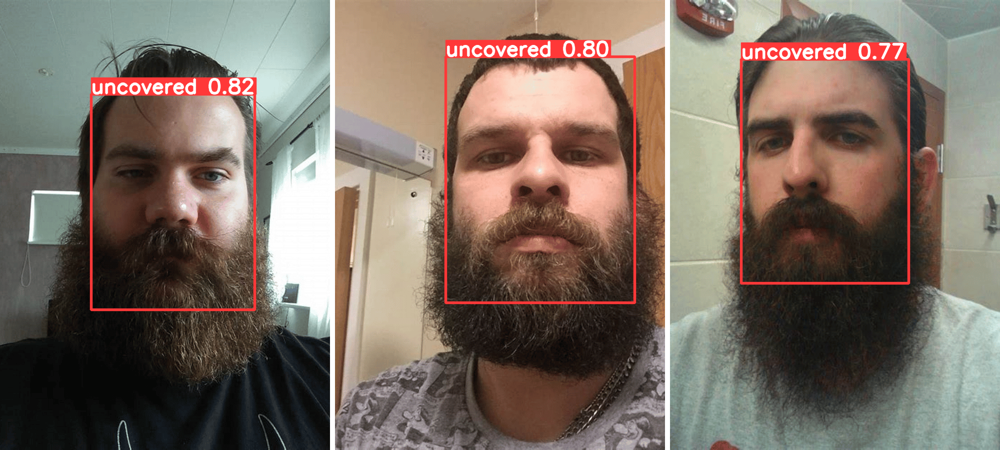

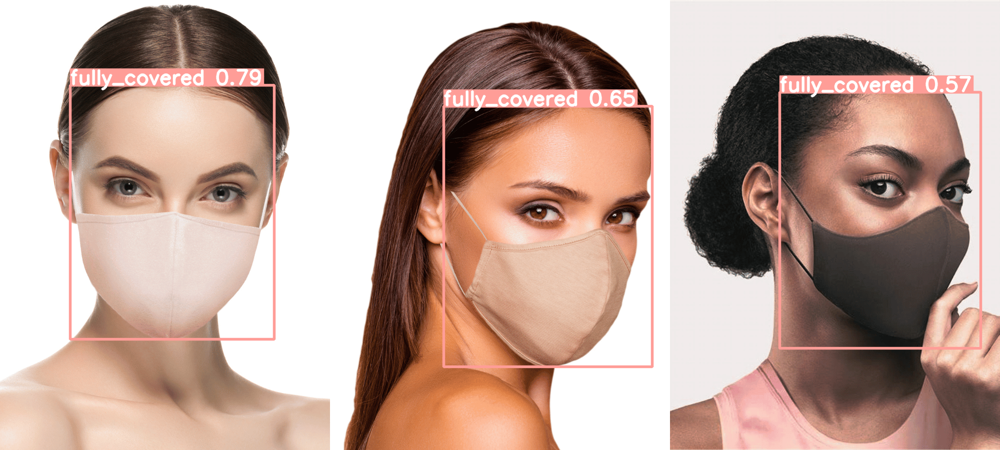

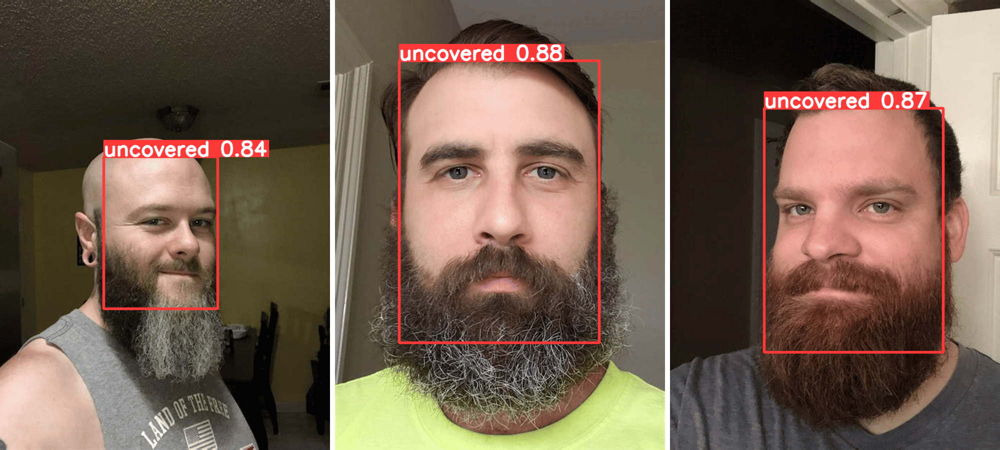

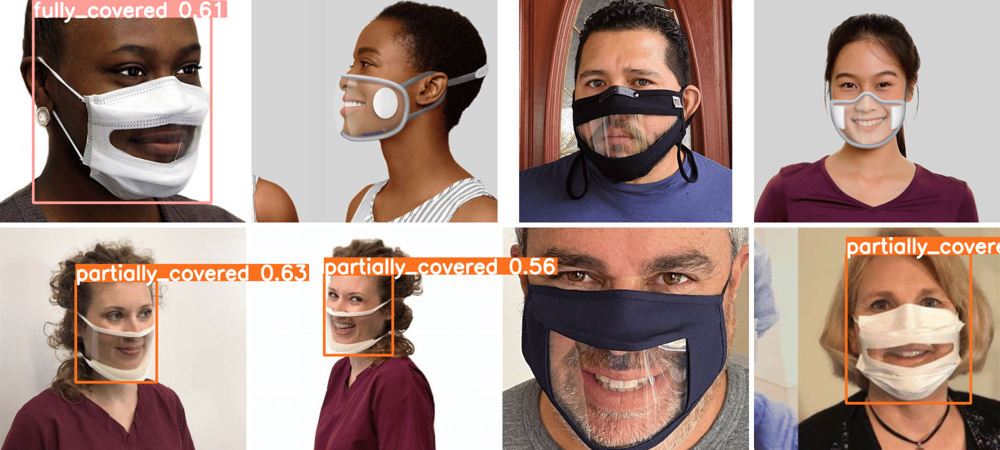

In [19]:
import glob
from IPython.display import display, Image

SOME_CASES = "/notebooks/nano/runs/detect/predict6"

for image_path in glob.glob(f'{SOME_CASES}/*.*'):
    display(Image(filename=image_path, width=700))
    print('\n')

In [20]:
!yolo task=detect mode=predict model={RES_PATH}/weights/best.pt conf=0.5 source="/notebooks/datasets/other_test_imgs/block_b.JPG" save=True

Ultralytics YOLOv8.0.114 🚀 Python-3.9.16 torch-1.12.1+cu116 CUDA:0 (NVIDIA RTX A4000, 16117MiB)
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

image 1/1 /notebooks/datasets/other_test_imgs/block_b.JPG: 576x640 1 uncovered, 16 fully_covereds, 9.8ms
Speed: 3.6ms preprocess, 9.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict7


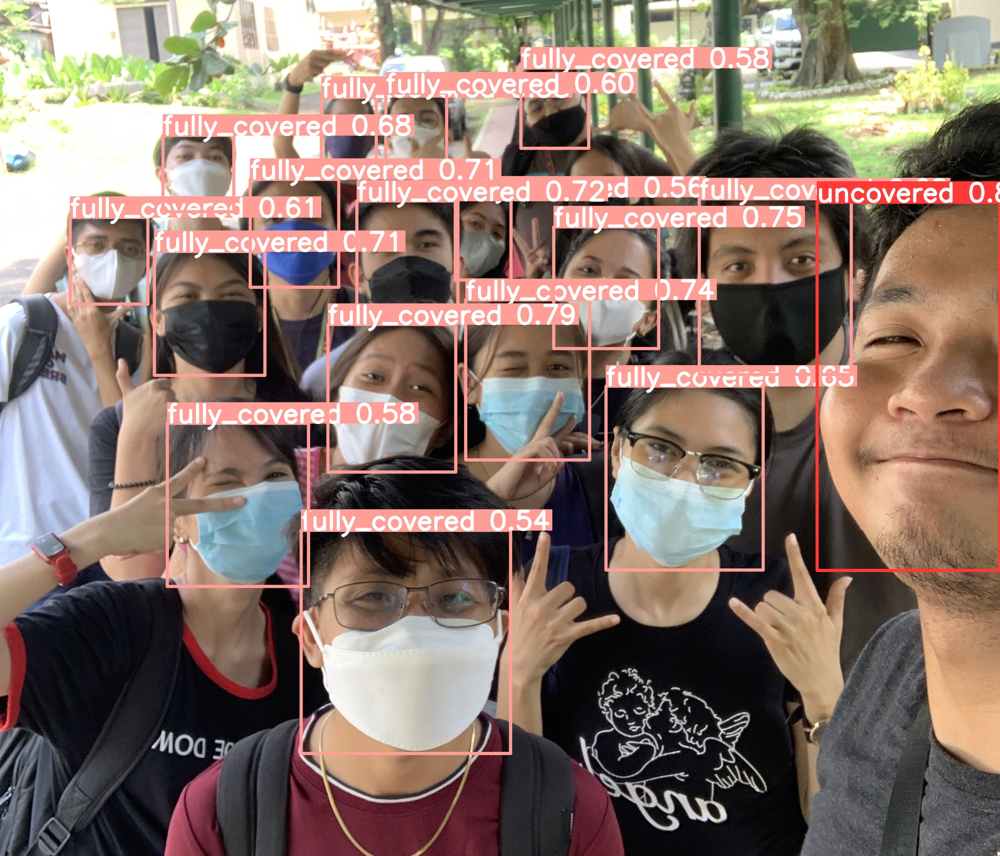

In [21]:
import glob
from IPython.display import display, Image

OTHER_CASES = "/notebooks/nano/runs/detect/predict7"

for image_path in glob.glob(f'{OTHER_CASES}/*.*'):
    display(Image(filename=image_path, width=700))
    print('\n')

In [6]:
# from ultralytics import YOLO

# model = YOLO('/notebooks/nano/runs/detect/train/weights/best.pt')
# source = '/notebooks/maskon_dataset/test/images'

-----


# Get Model's Inference Speed in CPU and GPU machines

### CPU Inference speed
* Both input and weight tensors must be running on CPU to run predictions correctly.
* Machine: 4-core CPU 8GB RAM

In [7]:
model.to("cpu")

# Test on CPU
results = model.predict(source, save=True, imgsz=640, conf=0.5, device="cpu")



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

image 1/3165 /notebooks/maskon_dataset/test/images/-1x-1_jpg.rf.a45473a343abb657cefa66adb8db92cf.jpg: 640x640 2 uncovereds, 2 fully_covereds, 157.5ms
image 2/3165 /notebooks/maskon_dataset/test/images/-I1-MS09uaqsLdGTFkgnS0Rcg1mmPyAj95ySg_eckoM_jpeg_jpg.rf.e689c0294bb6c6a98e565a4f7070d585.jpg: 640x640 2 fully_covereds, 88.5ms
image 3/3165 /notebooks/maskon_dataset/test/images/00003_Mask_Mouth_Chin_jpg.rf.48358e842329c6247a16b2de18a8ded9.jpg: 640x640 1 par

* Speed: 4.0ms preprocess, 261.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
* FPS = 1000 / (4.0 + 261.8 + 1.7) = 3.61 FPS

### GPU Inference speed
* Both input and weight tensors must be running on GPU to run predictions correctly.
* Machine: NVIDIA RTX A4000 | 45GB RAM 8CPU 16GPU

In [12]:
# model.to("cuda:0")

# Test on GPU
# results = model.predict(source, save=True, imgsz=640, conf=0.5, device=0)



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

image 1/3165 /notebooks/maskon_dataset/test/images/-1x-1_jpg.rf.a45473a343abb657cefa66adb8db92cf.jpg: 640x640 2 uncovereds, 2 fully_covereds, 7.2ms
image 2/3165 /notebooks/maskon_dataset/test/images/-I1-MS09uaqsLdGTFkgnS0Rcg1mmPyAj95ySg_eckoM_jpeg_jpg.rf.e689c0294bb6c6a98e565a4f7070d585.jpg: 640x640 2 fully_covereds, 7.8ms
image 3/3165 /notebooks/maskon_dataset/test/images/00003_Mask_Mouth_Chin_jpg.rf.48358e842329c6247a16b2de18a8ded9.jpg: 640x640 1 partia

* Speed: 1.3ms preprocess, 7.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
* FPS = 1000 / (1.3 + 7.0 + 1.2) = 107.14 FPS

## Export model to ONNX

In [13]:
!pip install protobuf==3.20.*

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 60.9 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.23.1
    Uninstalling protobuf-4.23.1:
      Successfully uninstalled protobuf-4.23.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.9.2 requires protobuf<3.20,>=3.9.2, but you have protobuf 3.20.3 which is incompatible.
tensorboard 2.9.1 requires protobuf<3.20,>=3.9.2, but you have protobuf 3.20.3 which is incompatible.


In [15]:
!yolo export model="/notebooks/nano/runs/detect/train/weights/best.pt" simplify=True format=onnx

Ultralytics YOLOv8.0.107 🚀 Python-3.9.16 torch-1.12.1+cu116 CPU
Model summary (fused): 168 layers, 3006233 parameters, 0 gradients

PyTorch: starting from /notebooks/nano/runs/detect/train/weights/best.pt with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 7, 8400) (6.0 MB)

ONNX: starting export with onnx 1.14.0 opset 10...
ONNX: simplifying with onnxsim 0.4.28...
ONNX: export success ✅ 1.8s, saved as /notebooks/nano/runs/detect/train/weights/best.onnx (11.6 MB)

Export complete (2.1s)
Results saved to /notebooks/nano/runs/detect/train/weights
Predict:         yolo predict task=detect model=/notebooks/nano/runs/detect/train/weights/best.onnx imgsz=640 
Validate:        yolo val task=detect model=/notebooks/nano/runs/detect/train/weights/best.onnx imgsz=640 data=/notebooks/maskon_dataset/data.yaml 
Visualize:       https://netron.app


In [1]:
!zip -r res_nano.zip '/notebooks/nano/runs/detect/train'

  adding: notebooks/nano/runs/detect/train/ (stored 0%)
  adding: notebooks/nano/runs/detect/train/val_batch0_pred.jpg (deflated 13%)
  adding: notebooks/nano/runs/detect/train/F1_curve.png (deflated 9%)
  adding: notebooks/nano/runs/detect/train/results.png (deflated 8%)
  adding: notebooks/nano/runs/detect/train/R_curve.png (deflated 11%)
  adding: notebooks/nano/runs/detect/train/val_batch1_labels.jpg (deflated 20%)
  adding: notebooks/nano/runs/detect/train/confusion_matrix.png (deflated 27%)
  adding: notebooks/nano/runs/detect/train/train_batch1.jpg (deflated 3%)
  adding: notebooks/nano/runs/detect/train/args.yaml (deflated 51%)
  adding: notebooks/nano/runs/detect/train/val_batch0_labels.jpg (deflated 14%)
  adding: notebooks/nano/runs/detect/train/weights/ (stored 0%)
  adding: notebooks/nano/runs/detect/train/weights/best.pt (deflated 9%)
  adding: notebooks/nano/runs/detect/train/weights/best.onnx (deflated 13%)
  adding: notebooks/nano/runs/detect/train/weights/last.pt (def

# 🚀 PERFORMANCE EVALUATION
Evaluate the performance of YOLO nano.

### YOLOv8 nano

In [15]:
# !pip install protobuf==3.20.*

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 68.1 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.23.1
    Uninstalling protobuf-4.23.1:
      Successfully uninstalled protobuf-4.23.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.9.2 requires protobuf<3.20,>=3.9.2, but you have protobuf 3.20.3 which is incompatible.
tensorboard 2.9.1 requires protobuf<3.20,>=3.9.2, but you have protobuf 3.20.3 which is incompatible.


In [1]:
# !yolo benchmark model='/notebooks/experiments/nano/runs/detect/train/weights/best.pt' imgsz=640 device=cpu


image 1/1 /usr/local/lib/python3.9/dist-packages/ultralytics/assets/bus.jpg: 640x480 2 uncovereds, 110.8ms
Speed: 2.9ms preprocess, 110.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Ultralytics YOLOv8.0.105 🚀 Python-3.9.16 torch-1.12.1+cu116 CPU
val: Scanning /notebooks/experiments/nano/datasets/coco8/labels/val.cache... 4 i
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all          4         17          0          0          0          0
Speed: 0.8ms preprocess, 76.8ms inference, 0.0ms loss, 0.7ms postprocess per image
Ultralytics YOLOv8.0.105 🚀 Python-3.9.16 torch-1.12.1+cu116 CPU

PyTorch: starting from /notebooks/experiments/nano/runs/detect/train/weights/best.pt with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 7, 8400) (6.0 MB)

TorchScript: starting export with torch 1.12.1+cu116...
TorchScript: export success ✅ 2.6s, saved as /notebooks/experiments/nano/runs/detect/train/weights/best.torc

-----

In [16]:
!pip install deepsparse[yolo] ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.4/40.4 MB 33.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 100.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 80.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 65.8 MB/s eta 0:00:0000:010:01m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.0/92.0 kB 26.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.5/97.5 kB 27.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.1/19.1 MB 80.2 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 776.3/776.3 MB 3.4 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: torch
    Found existing installation: torch 1.12.1+cu116
    Uninstalling torch-1.12.1+cu116:
      Successfully uninstalled torch-1.12.1+cu116
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully

### YOLOv8 nano (ONNX Runtime with default parameters)

In [17]:
# /notebooks/experiments/nano/runs/detect/train/weights/best.onnx
!deepsparse.benchmark '/notebooks/nano/runs/detect/train/weights/best.onnx' --scenario=sync --input_shapes="[1,3,640,640]" --num_cores=4 --engine=onnxruntime

2023-05-24 04:42:38 deepsparse.benchmark.benchmark_model INFO     Thread pinning to cores enabled
2023-05-24 04:42:38 deepsparse.benchmark.benchmark_model INFO     ORTEngine:
	onnx_file_path: /notebooks/nano/runs/detect/train/weights/best.onnx
	batch_size: 1
	num_cores: 4
	providers: ['CPUExecutionProvider']
2023-05-24 04:42:38 deepsparse.utils.onnx INFO     Generating input 'images', type = float32, shape = [1, 3, 640, 640]
2023-05-24 04:42:38 deepsparse.benchmark.benchmark_model INFO     Starting 'singlestream' performance measurements for 10 seconds
Original Model Path: /notebooks/nano/runs/detect/train/weights/best.onnx
Batch Size: 1
Scenario: sync
Throughput (items/sec): 21.4496
Latency Mean (ms/batch): 46.6111
Latency Median (ms/batch): 46.2106
Latency Std (ms/batch): 2.0912
Iterations: 215


**At batch 1, ONNX Runtime achieves approx. 21 images/sec with our fine-tuned model based on YOLOv8n.**

### YOLOv8 nano (ONNX Runtime - Pytorch)

In [20]:
!deepsparse.benchmark "zoo:cv/detection/yolov8-n/pytorch/ultralytics/coco/base-none" --scenario=sync --input_shapes="[1,3,640,640]" --num_cores=4 --engine=onnxruntime

2023-05-24 04:48:06 deepsparse.benchmark.benchmark_model INFO     Thread pinning to cores enabled
2023-05-24 04:48:09 deepsparse.benchmark.benchmark_model INFO     ORTEngine:
	onnx_file_path: /root/.cache/sparsezoo/edebad67-e16b-4d06-98a5-ddbcaa95afc4/model.onnx
	batch_size: 1
	num_cores: 4
	providers: ['CPUExecutionProvider']
INFO:deepsparse.benchmark.benchmark_model:ORTEngine:
	onnx_file_path: /root/.cache/sparsezoo/edebad67-e16b-4d06-98a5-ddbcaa95afc4/model.onnx
	batch_size: 1
	num_cores: 4
	providers: ['CPUExecutionProvider']
2023-05-24 04:48:09 deepsparse.utils.onnx INFO     Generating input 'images', type = float32, shape = [1, 3, 640, 640]
INFO:deepsparse.utils.onnx:Generating input 'images', type = float32, shape = [1, 3, 640, 640]
2023-05-24 04:48:09 deepsparse.benchmark.benchmark_model INFO     Starting 'singlestream' performance measurements for 10 seconds
INFO:deepsparse.benchmark.benchmark_model:Starting 'singlestream' performance measurements for 10 seconds
Original Model

**At batch 1, ONNX Runtime achieves approx. 18 images/sec with the standard, dense YOLOv5n.**

-----